[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/14hlK1MWQ-N6YhoE40RRgUjw9Z5PXc4qR)

<img src = https://learnopencv.com/wp-content/uploads/2024/09/Sapiens-Feature-Img-Foundation-for-Human-Vision-Models.gif>

### Installing Dependencies

In [ ]:
!git clone https://github.com/ibaiGorordo/Sapiens-Pytorch-Inference.git

Cloning into 'Sapiens-Pytorch-Inference'...
remote: Enumerating objects: 157, done.
remote: Counting objects: 100% (157/157), done.
remote: Compressing objects: 100% (103/103), done.
remote: Total 157 (delta 101), reused 103 (delta 52), pack-reused 0 (from 0)
Receiving objects: 100% (157/157), 2.87 MiB | 2.74 MiB/s, done.
Resolving deltas: 100% (101/101), done.


In [ ]:
%cd Sapiens-Pytorch-Inference

/home/opencvuniv/Work/jay/Sapiens/Sapiens-Pytorch-Inference


/home/opencvuniv/miniconda3/envs/torch_241_cu118/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [ ]:
# !pip install -r requirements.txt -q

In [ ]:
pwd

'/content/Sapiens-Pytorch-Inference'

In [ ]:
import os
import sys
import shutil
from typing import List
import requests
from tqdm import tqdm
from datetime import timedelta

from enum import Enum
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
from imread_from_url import imread_from_url

from dataclasses import dataclass
from torchvision import transforms
import torch
import torch.nn.functional as F

from huggingface_hub import hf_hub_download, hf_hub_url

/home/opencvuniv/miniconda3/envs/torch_241_cu118/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Download Test Images

In [ ]:
import os
os.makedirs("test_images/", exist_ok = True)

!wget -nc https://learnopencv.com/wp-content/uploads/2024/09/man-horse-arrow-scaled.jpg -O test_images/man-horse-arrow.jpg

!wget -nc https://learnopencv.com/wp-content/uploads/2024/09/football-soccer-scaled.jpg -O test_images/football.jpg
!wget -nc https://learnopencv.com/wp-content/uploads/2024/09/jogging-1-scaled.jpg -O test_images/jogging.jpg

!wget -nc https://learnopencv.com/wp-content/uploads/2024/09/Sapiens-video-test.mp4 -O test_images/Sapiens-video-test.mp4


--2024-09-23 16:02:28--  https://learnopencv.com/wp-content/uploads/2024/09/man-horse-arrow-scaled.jpg
Resolving learnopencv.com (learnopencv.com)... 172.66.42.215, 172.66.41.41, 2606:4700:3108::ac42:2929, ...
Connecting to learnopencv.com (learnopencv.com)|172.66.42.215|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 109854 (107K) [image/jpeg]
Saving to: ‘test_images/man-horse-arrow.jpg’

test_images/man-hor 100%[===================>] 107.28K  --.-KB/s    in 0.04s   

2024-09-23 16:02:28 (2.91 MB/s) - ‘test_images/man-horse-arrow.jpg’ saved [109854/109854]

--2024-09-23 16:02:28--  https://learnopencv.com/wp-content/uploads/2024/09/football-soccer-scaled.jpg
Resolving learnopencv.com (learnopencv.com)... 172.66.41.41, 172.66.42.215, 2606:4700:3108::ac42:2ad7, ...
Connecting to learnopencv.com (learnopencv.com)|172.66.41.41|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 82891 (81K) [image/jpeg]
Saving to: ‘test_images/football.jpg’



### Download Sapiens-1B Model for all tasks

In [ ]:
!wget -nc https://huggingface.co/facebook/sapiens-normal-1b-torchscript/resolve/main/sapiens_1b_normal_render_people_epoch_115_torchscript.pt2  -O models/sapiens_1b_normal_render_people_epoch_115_torchscript.pt2

!wget -nc https://huggingface.co/facebook/sapiens-seg-1b-torchscript/resolve/main/sapiens_1b_goliath_best_goliath_mIoU_7994_epoch_151_torchscript.pt2 -O models/sapiens_1b_goliath_best_goliath_mIoU_7994_epoch_151_torchscript.pt2

!wget -nc https://huggingface.co/facebook/sapiens-depth-1b-torchscript/resolve/main/sapiens_1b_render_people_epoch_88_torchscript.pt2 -O models/sapiens_1b_render_people_epoch_88_torchscript.pt2

!wget -nc https://huggingface.co/facebook/sapiens-pose-1b-torchscript/resolve/main/sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2 -O models/sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2

--2024-09-23 16:03:44--  https://huggingface.co/facebook/sapiens-pose-1b-torchscript/resolve/main/sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2
Resolving huggingface.co (huggingface.co)... 18.155.99.94, 18.155.99.56, 18.155.99.91, ...
Connecting to huggingface.co (huggingface.co)|18.155.99.94|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs-us-1.huggingface.co/repos/58/78/5878ffb4f3c9a6e45887705f398a57f2b5e78cdb65e7687bfd112112c53de0f9/c6218c6be17697157f9e65ee34054a94ab8ca0f637380fa5748c18e04814976e?response-content-disposition=inline%3B+filename*%3DUTF-8%27%27sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2%3B+filename%3D%22sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2%22%3B&Expires=1727346825&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcyNzM0NjgyNX19LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy11cy0xLmh1Z2dpbmdmYWNlLmNvL3JlcG9zLzU4Lzc4LzU4NzhmZmI0ZjNjOWE2ZTQ1ODg3NzA1ZjM5OGE1N2Y

### Common Utilities

In [ ]:
class TaskType(Enum):
    DEPTH = "depth"
    NORMAL = "normal"
    SEG = "seg"
    POSE = "pose"


def download(url: str, filename: str):
    with open(filename, 'wb') as f:
        with requests.get(url, stream=True) as r:
            r.raise_for_status()
            total = int(r.headers.get('content-length', 0))

            # tqdm has many interesting parameters. Feel free to experiment!
            tqdm_params = {
                'total': total,
                'miniters': 1,
                'unit': 'B',
                'unit_scale': True,
                'unit_divisor': 1024,
            }
            with tqdm(**tqdm_params) as pb:
                for chunk in r.iter_content(chunk_size=8192):
                    pb.update(len(chunk))
                    f.write(chunk)


def download_hf_model(model_name: str, task_type: TaskType, model_dir: str = 'models'):
    if not os.path.exists(model_dir):
        os.makedirs(model_dir)

    path = model_dir + "/" + model_name
    if os.path.exists(path):
        return path

    print(f"Model {model_name} not found, downloading from Hugging Face Hub...")

    model_version = "_".join(model_name.split("_")[:2])
    repo_id = "facebook/sapiens"
    subdirectory = f"sapiens_lite_host/torchscript/{task_type.value}/checkpoints/{model_version}"

    # hf_hub_download(repo_id=repo_id, filename=model_name, subfolder=subdirectory, local_dir=model_dir)
    url = hf_hub_url(repo_id=repo_id, filename=model_name, subfolder=subdirectory)
    download(url, path)
    print("Model downloaded successfully to", path)

    return path


def create_preprocessor(input_size: tuple[int, int],
                        mean: List[float] = (0.485, 0.456, 0.406),
                        std: List[float] = (0.229, 0.224, 0.225)):
    return transforms.Compose([transforms.ToPILImage(),
                               transforms.Resize(input_size),
                               transforms.ToTensor(),
                               transforms.Normalize(mean=mean, std=std),
                               transforms.Lambda(lambda x: x.unsqueeze(0))
                               ])


### Pose Estimation

In [ ]:
from ultralytics import YOLO

@dataclass
class DetectorConfig:
    model_path: str = "models/yolov8m.pt"
    person_id: int = 0
    conf_thres: float = 0.25


def draw_boxes(img, boxes, color=(0, 255, 0), thickness=2):
    draw_img = img.copy()
    for box in boxes:
        x1, y1, x2, y2 = box
        draw_img = cv2.rectangle(draw_img, (x1, y1), (x2, y2), color, thickness)
    return draw_img


class Detector:
    def __init__(self, config: DetectorConfig = DetectorConfig()):
        model_path = config.model_path
        if not model_path.endswith(".pt"):
            model_path = model_path.split(".")[0] + ".pt"
        self.model = YOLO(model_path)
        self.person_id = config.person_id
        self.conf_thres = config.conf_thres

    def __call__(self, img: np.ndarray) -> np.ndarray:
        return self.detect(img)

    def detect(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()
        results = self.model(img, conf=self.conf_thres)
        detections = results[0].boxes.data.cpu().numpy()  # (x1, y1, x2, y2, conf, cls)

        # Filter out only person
        person_detections = detections[detections[:, -1] == self.person_id]
        boxes = person_detections[:, :-2].astype(int)

        print(f"Detection inference took: {time.perf_counter() - start:.4f} seconds")
        return boxes


In [ ]:
!wget https://huggingface.co/spaces/facebook/sapiens-pose/resolve/main/classes_and_palettes.py -O classes_and_palettes.py

--2024-09-23 16:29:18--  https://huggingface.co/spaces/facebook/sapiens-pose/resolve/main/classes_and_palettes.py
Resolving huggingface.co (huggingface.co)... 18.155.99.94, 18.155.99.2, 18.155.99.91, ...
Connecting to huggingface.co (huggingface.co)|18.155.99.94|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 40865 (40K) [text/plain]
Saving to: ‘classes_and_palettes.py’

classes_and_palette 100%[===================>]  39.91K   185KB/s    in 0.2s    

2024-09-23 16:29:19 (185 KB/s) - ‘classes_and_palettes.py’ saved [40865/40865]



In [ ]:
from classes_and_palettes import (
    COCO_KPTS_COLORS,
    COCO_WHOLEBODY_KPTS_COLORS,
    GOLIATH_KPTS_COLORS,
    GOLIATH_SKELETON_INFO,
    GOLIATH_KEYPOINTS
)

class SapiensPoseEstimationType(Enum):
    POSE_ESTIMATION_1B = "sapiens_1b_goliath_best_goliath_AP_640_torchscript.pt2"



In [ ]:
class SapiensPoseEstimation:
    def __init__(self,
                 type: SapiensPoseEstimationType = SapiensPoseEstimationType.POSE_ESTIMATION_1B,
                 device: torch.device = torch.device("cuda" if torch.cuda.is_available() else "cpu"),
                 dtype: torch.dtype = torch.float32):
        # Load the model
        self.device = device
        self.dtype = dtype
        path = download_hf_model(type.value, TaskType.POSE)
        self.model = torch.jit.load(path).eval().to(device).to(dtype)
        self.preprocessor = transforms.Compose([transforms.ToPILImage(),
                               transforms.Resize((1024,768)),
                               transforms.ToTensor(),
                               transforms.Normalize(mean=mean, std=std),
                               ])

        # Initialize the YOLO-based detector
        self.detector = Detector()



    def __call__(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()

        # Detect persons in the image
        bboxes = self.detector.detect(img)

        # Process the image and estimate the pose
        pose_result_image, keypoints = self.estimate_pose(img, bboxes)

        print(f"Pose estimation inference took: {time.perf_counter() - start:.4f} seconds")
        return pose_result_image, keypoints


    @torch.inference_mode()
    def estimate_pose(self, img: np.ndarray, bboxes: List[List[float]]) -> (np.ndarray, List[dict]):
        all_keypoints = []
        result_img = img.copy()

        for bbox in bboxes:
            cropped_img = self.crop_image(img, bbox)
            tensor = self.preprocessor(cropped_img).unsqueeze(0).to(self.device).to(self.dtype)

            heatmaps = self.model(tensor)
            keypoints = self.heatmaps_to_keypoints(heatmaps[0].cpu().numpy())
            all_keypoints.append(keypoints)

            # Draw the keypoints on the original image
            result_img = self.draw_keypoints(result_img, keypoints, bbox)

        return result_img, all_keypoints

    def crop_image(self, img: np.ndarray, bbox: List[float]) -> np.ndarray:
        x1, y1, x2, y2 = map(int, bbox[:4])
        return img[y1:y2, x1:x2]


    def heatmaps_to_keypoints(self, heatmaps: np.ndarray) -> dict:
        keypoints = {}
        for i, name in enumerate(GOLIATH_KEYPOINTS):
            if i < heatmaps.shape[0]:
                y, x = np.unravel_index(np.argmax(heatmaps[i]), heatmaps[i].shape)
                conf = heatmaps[i, y, x]
                keypoints[name] = (float(x), float(y), float(conf))
        return keypoints



    def draw_keypoints(self, img: np.ndarray, keypoints: dict, bbox: List[float]) -> np.ndarray:
        x1, y1, x2, y2 = map(int, bbox[:4])
        bbox_width, bbox_height = x2 - x1, y2 - y1
        img_copy = img.copy()

        # Draw keypoints on the image
        for i, (name, (x, y, conf)) in enumerate(keypoints.items()):
            if conf > 0.3:  # Only draw confident keypoints
                x_coord = int(x * bbox_width / 192) + x1
                y_coord = int(y * bbox_height / 256) + y1
                cv2.circle(img_copy, (x_coord, y_coord), 3, GOLIATH_KPTS_COLORS[i], -1)

        # Optionally draw skeleton
        for _, link_info in GOLIATH_SKELETON_INFO.items():
            pt1_name, pt2_name = link_info['link']
            if pt1_name in keypoints and pt2_name in keypoints:
                pt1 = keypoints[pt1_name]
                pt2 = keypoints[pt2_name]
                if pt1[2] > 0.3 and pt2[2] > 0.3:
                    x1_coord = int(pt1[0] * bbox_width / 192) + x1
                    y1_coord = int(pt1[1] * bbox_height / 256) + y1
                    x2_coord = int(pt2[0] * bbox_width / 192) + x1
                    y2_coord = int(pt2[1] * bbox_height / 256) + y1
                    cv2.line(img_copy, (x1_coord, y1_coord), (x2_coord, y2_coord), GOLIATH_KPTS_COLORS[i], 2)

        return img_copy



0: 640x416 1 person, 1 sports ball, 29.0ms
Speed: 1.0ms preprocess, 29.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 416)
Detection inference took: 0.1433 seconds
Pose estimation inference took: 0.9752 seconds
Time taken: 0.9753 seconds


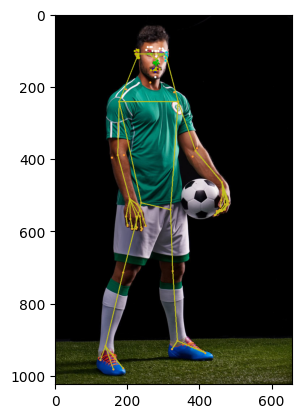

In [ ]:
if __name__ == "__main__":
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    pose_estimator = SapiensPoseEstimation()

    img_path = "test_images/football.jpg"
    img = cv2.imread(img_path)

    # Perform pose estimation
    start_time = time.perf_counter()
    result_img, keypoints = pose_estimator(img)

    height, width, _ = result_img.shape

    fig = plt.figure(figsize = (width/100, height/100), dpi=100)

    print(f"Time taken: {time.perf_counter() - start_time:.4f} seconds")

    result_img_rgb = result_img[:,:,::-1]

    plt.imshow(result_img_rgb)
    plt.axis('off')

    plt.savefig("pose_output_rgb.png", bbox_inches 'tight', pad_inches = 0)
    plt.show()

del pose_estimator
torch.cuda.empty_cache()

### Depth Estimation - without BG removal

In [ ]:
# from sapiens_inference.common import create_preprocessor, download_hf_model, TaskType


class SapiensDepthType(Enum):
    OFF = "off"
    # DEPTH_03B = "sapiens_0.3b_render_people_epoch_100_torchscript.pt2"
    # DEPTH_06B = "sapiens_0.6b_render_people_epoch_70_torchscript.pt2"
    DEPTH_1B = "sapiens_1b_render_people_epoch_88_torchscript.pt2"
    # DEPTH_2B = "sapiens_2b_render_people_epoch_25_torchscript.pt2"


class SapiensDepth():
    def __init__(self,
                 type: SapiensDepthType = SapiensDepthType.DEPTH_1B,
                 device: torch.device = torch.device("cuda" if torch.cuda.is_available() else "cpu"),
                 dtype: torch.dtype = torch.float32):
        path = download_hf_model(type.value, TaskType.DEPTH)
        model = torch.jit.load(path)
        model = model.eval()
        self.model = model.to(device).to(dtype)
        self.device = device
        self.dtype = dtype
        self.preprocessor = create_preprocessor(input_size=(1024, 768))  # Finetuned image resolutions

    def __call__(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()

        # Model expects BGR, but we change to RGB here because the preprocessor will switch the channels also
        input = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        tensor = self.preprocessor(input).to(self.device).to(self.dtype)

        with torch.inference_mode():
            results = self.model(tensor)

        depth_map = postprocess_depth(results, img.shape[:2])
        print(f"Depth inference took: {time.perf_counter() - start:.4f} seconds")
        return depth_map


In [ ]:
def draw_depth_map(depth_map: np.ndarray) -> np.ndarray:
    min_depth, max_depth = np.min(depth_map), np.max(depth_map)

    norm_depth_map = 1 - (depth_map - min_depth) / (max_depth - min_depth)
    norm_depth_map = (norm_depth_map * 255).astype(np.uint8)

    # Normalize and color the image
    color_depth = cv2.applyColorMap(norm_depth_map, cv2.COLORMAP_INFERNO)
    color_depth[depth_map == 0] = 128 #background
    return color_depth


def postprocess_depth(results: torch.Tensor, img_shape: tuple[int, int]) -> np.ndarray:
    result = results[0].cpu()

    # Upsample the result to the original image size
    logits = F.interpolate(result.unsqueeze(0), size=img_shape, mode="bilinear").squeeze(0)

    # Covert to numpy array
    depth_map = logits.float().numpy().squeeze()
    return depth_map

Depth inference took: 4.1430 seconds
Time taken: 4.1441 seconds


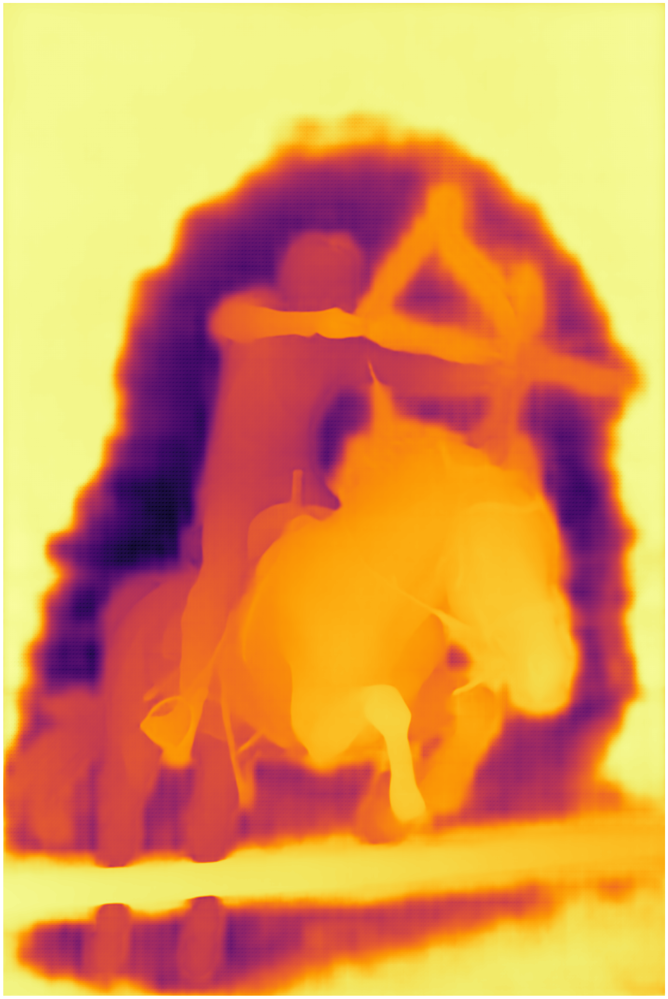

In [ ]:
if __name__ == "__main__":
    type = torch.float16
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Load the image
    img_path = "test_images/man-horse-bow-arrow.jpg"
    img = cv2.imread(img_path)

    # Initialize the depth estimator
    model_type = SapiensDepthType.DEPTH_1B
    estimator = SapiensDepth(model_type)

    # Estimate depth and measure time
    start = time.perf_counter()
    depth_map = estimator(img)  # Use the RGB image for depth estimation
    print(f"Time taken: {time.perf_counter() - start:.4f} seconds")

    # Draw the depth map
    depth_img = draw_depth_map(depth_map)

    # Convert depth_img from BGR to RGB for visualization and saving
    depth_img_rgb = cv2.cvtColor(depth_img, cv2.COLOR_BGR2RGB)

    height, width, _ = depth_img_rgb.shape

    fig = plt.figure(figsize = (width/100, height/100), dpi=100)

    # Display and save the RGB depth image
    plt.imshow(depth_img_rgb)
    plt.axis('off')  # Hide the axis

    # Save the depth image as RGB
    plt.savefig("depth_image_rgb.png", bbox_inches='tight', pad_inches=0)
    plt.show()

    # Free the GPU memory
    del estimator  # Delete the model
    torch.cuda.empty_cache()  # Clear the GPU cache

### Surface Normal

In [ ]:
class SapiensNormalType(Enum):
    OFF = "off"
    # NORMAL_03B = "sapiens_0.3b_normal_render_people_epoch_66_torchscript.pt2"
    # NORMAL_06B = "sapiens_0.6b_normal_render_people_epoch_200_torchscript.pt2"
    NORMAL_1B = "sapiens_1b_normal_render_people_epoch_115_torchscript.pt2"
    # NORMAL_2B = "sapiens_2b_normal_render_people_epoch_70_torchscript.pt2"


class SapiensNormal():
    def __init__(self,
                 type: SapiensNormalType = SapiensNormalType.NORMAL_1B,
                 device: torch.device = torch.device("cuda" if torch.cuda.is_available() else "cpu"),
                 dtype: torch.dtype = torch.float32):
        path = download_hf_model(type.value, TaskType.NORMAL)
        model = torch.jit.load(path)
        model = model.eval()
        self.model = model.to(device).to(dtype)
        self.device = device
        self.dtype = dtype
        self.preprocessor = create_preprocessor(input_size=(1024, 768))  
    def __call__(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()

        # Model expects BGR, but we change to RGB here because the preprocessor will switch the channels also
        input = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        tensor = self.preprocessor(input).to(self.device).to(self.dtype)

        with torch.inference_mode():
            results = self.model(tensor)

        normals = postprocess_normal(results, img.shape[:2])
        print(f"Normal inference took: {time.perf_counter() - start:.4f} seconds")
        return normals

In [ ]:
def draw_normal_map(normal_map: np.ndarray) -> np.ndarray:
    # Normalize the normal map
    normal_map_norm = np.linalg.norm(normal_map, axis=-1, keepdims=True)
    normal_map_normalized = normal_map / (normal_map_norm + 1e-5)  # Add a small epsilon to avoid division by zero
    normal_map = ((normal_map_normalized + 1) / 2 * 255).astype(np.uint8)

    # Convert to BGR
    return cv2.cvtColor(normal_map, cv2.COLOR_RGB2BGR)


def postprocess_normal(results: torch.Tensor, img_shape: tuple[int, int]) -> np.ndarray:
    result = results[0].detach().cpu()

    # Upsample the result to the original image size
    logits = F.interpolate(result.unsqueeze(0), size=img_shape, mode="bilinear").squeeze(0)

    # Covert to numpy array
    normal_map = logits.float().numpy().transpose(1, 2, 0)

    return normal_map

Normal inference took: 4.7893 seconds
Time taken: 4.7902 seconds


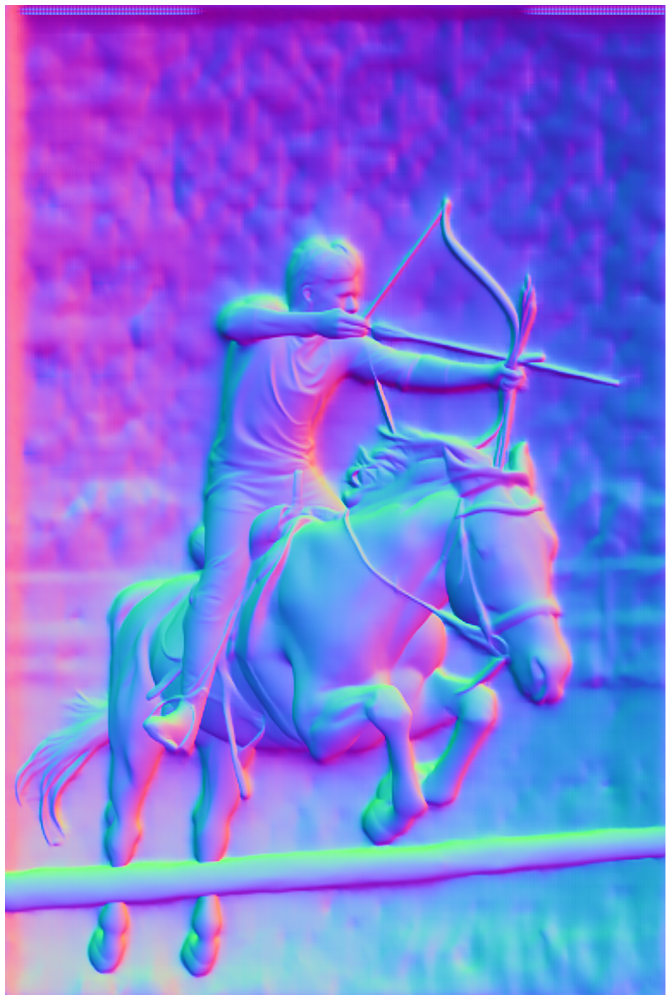

In [ ]:
if __name__ == "__main__":

    img_path = "test_images/man-horse-arrow.jpg"
    img = cv2.imread(img_path)

    model_type = SapiensNormalType.NORMAL_1B
    estimator = SapiensNormal(model_type)

    start = time.perf_counter()
    normals = estimator(img)
    print(f"Time taken: {time.perf_counter() - start:.4f} seconds")

    normal_img = draw_normal_map(normals)

    # Convert depth_img from BGR to RGB for visualization and saving
    normal_img_rgb = cv2.cvtColor(normal_img, cv2.COLOR_BGR2RGB)

    height, width, _ = normal_img_rgb.shape

    fig = plt.figure(figsize = (width/100, height/100), dpi=100)

    # Display and save the RGB depth image
    plt.imshow(normal_img_rgb)
    plt.axis('off')  # Hide the axis

    # Save the depth image as RGB
    plt.savefig("normal_image_rgb.png", bbox_inches='tight', pad_inches=0)
    plt.show()

    # Free the GPU memory
    del estimator  # Delete the model
    torch.cuda.empty_cache()  # Clear the GPU cache

### Body Part Segmentation - 28 classes

In [ ]:
class SapiensSegmentationType(Enum):
    # SEGMENTATION_03B = "sapiens_0.3b_goliath_best_goliath_mIoU_7673_epoch_194_torchscript.pt2"
    # SEGMENTATION_06B = "sapiens_0.6b_goliath_best_goliath_mIoU_7777_epoch_178_torchscript.pt2"
    SEGMENTATION_1B = "sapiens_1b_goliath_best_goliath_mIoU_7994_epoch_151_torchscript.pt2"


random = np.random.RandomState(11)

# --------------------------------**** 28 Classes **** --------------------------------------------------------------
classes = ["Background", "Apparel", "Face Neck", "Hair", "Left Foot", "Left Hand", "Left Lower Arm", "Left Lower Leg",
           "Left Shoe", "Left Sock", "Left Upper Arm", "Left Upper Leg", "Lower Clothing", "Right Foot", "Right Hand",
           "Right Lower Arm", "Right Lower Leg", "Right Shoe", "Right Sock", "Right Upper Arm", "Right Upper Leg",
           "Torso", "Upper Clothing", "Lower Lip", "Upper Lip", "Lower Teeth", "Upper Teeth", "Tongue"]

colors = random.randint(0, 255, (len(classes) - 1, 3))
colors = np.vstack((np.array([128, 128, 128]), colors)).astype(np.uint8)  # Add background color
colors = colors[:, ::-1]


In [ ]:
class SapiensSegmentation():
    def __init__(self,
                 type: SapiensSegmentationType = SapiensSegmentationType.SEGMENTATION_1B,
                 device: torch.device = torch.device("cuda" if torch.cuda.is_available() else "cpu"),
                 dtype: torch.dtype = torch.float32):
        path = download_hf_model(type.value, TaskType.SEG)
        model = torch.jit.load(path)
        model = model.eval()
        self.model = model.to(device).to(dtype)
        self.device = device
        self.dtype = dtype
        self.preprocessor = create_preprocessor(input_size=(1024, 768))  

    def __call__(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()

        # Model expects BGR, but we change to RGB here because the preprocessor will switch the channels also
        input = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        tensor = self.preprocessor(input).to(self.device).to(self.dtype)

        with torch.inference_mode():
            results = self.model(tensor)
        segmentation_map = postprocess_segmentation(results, img.shape[:2])

        print(f"Segmentation inference took: {time.perf_counter() - start:.4f} seconds")
        return segmentation_map


In [ ]:

def draw_segmentation_map(segmentation_map: np.ndarray) -> np.ndarray:
    h, w = segmentation_map.shape #single channel
    segmentation_img = np.zeros((h, w, 3), dtype=np.uint8) #3 channels

    for i, color in enumerate(colors):
        segmentation_img[segmentation_map == i] = color

    return segmentation_img


def postprocess_segmentation(results: torch.Tensor, img_shape: tuple[int, int]) -> np.ndarray:
    result = results[0].cpu()

    # Upsample the result to the original image size
    logits = F.interpolate(result.unsqueeze(0), size=img_shape, mode="bilinear").squeeze(0)

    # Perform argmax to get the segmentation map
    segmentation_map = logits.argmax(dim=0, keepdim=True)

    # Covert to numpy array
    segmentation_map = segmentation_map.float().numpy().squeeze()

    return segmentation_map

Segmentation inference took: 7.3527 seconds
Time taken: 7.3537 seconds


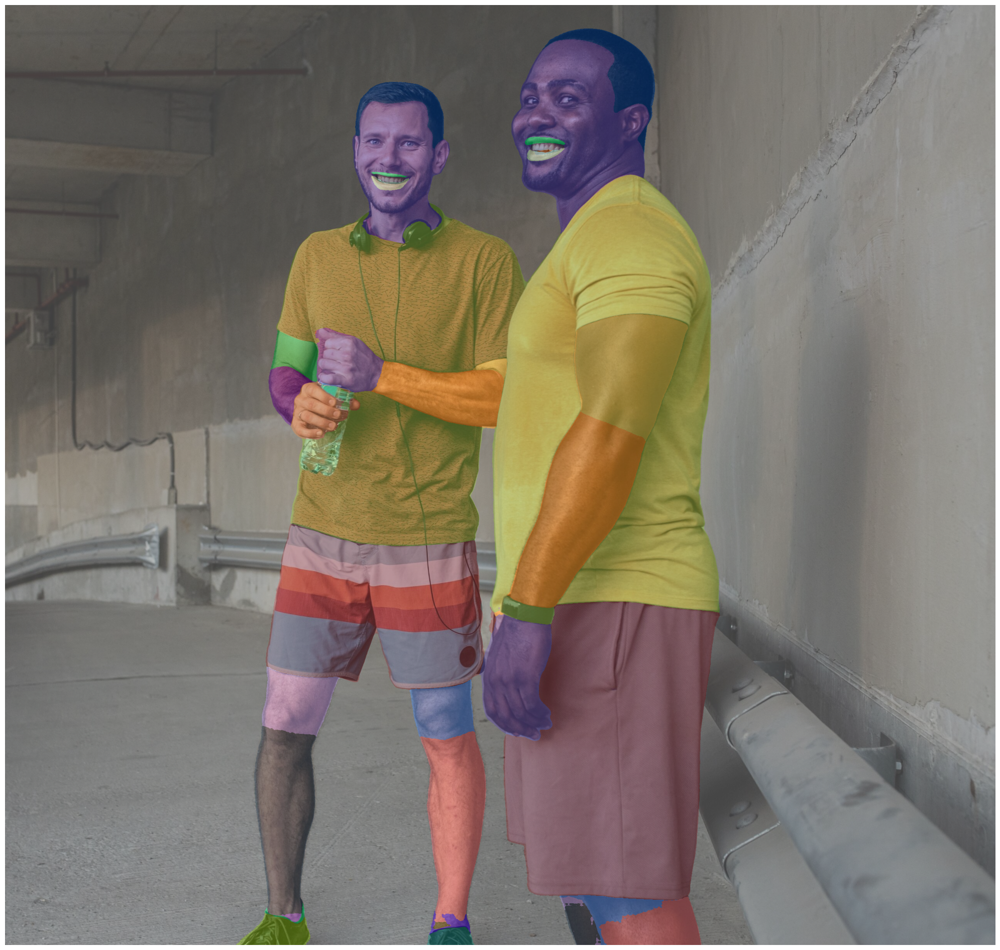

In [ ]:
if __name__ == "__main__":
    type = torch.float32
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    img_path = "test_images/jogging.jpg"
    img = cv2.imread(img_path)

    model_type = SapiensSegmentationType.SEGMENTATION_1B
    estimator = SapiensSegmentation(model_type)

    start = time.perf_counter()
    segmentations = estimator(img)
    print(f"Time taken: {time.perf_counter() - start:.4f} seconds")

    segmentation_img = draw_segmentation_map(segmentations)
    combined = cv2.addWeighted(img, 0.5, segmentation_img, 0.5, 0)

     # Convert depth_img from BGR to RGB for visualization and saving
    segmented_img_rgb = cv2.cvtColor(combined, cv2.COLOR_BGR2RGB)

    height, width, _ = segmented_img_rgb.shape

    fig = plt.figure(figsize=(width / 100, height / 100), dpi=100)


    # Display and save the RGB depth image
    plt.imshow(segmented_img_rgb)
    plt.axis('off')  # Hide the axis

    # Save the depth image as RGB
    plt.savefig("segmented_image_rgb.png", bbox_inches='tight', pad_inches=0)
    plt.show()


In [ ]:
# Free the GPU memory
# del estimator  # Delete the model
torch.cuda.empty_cache()  # Clear the GPU cache

In [ ]:
# !sudo apt install tree

### Predictor - Segmentation, Surface Normal, Depth Estimation

In [ ]:
!tree /content/Sapiens-Pytorch-Inference/sapiens_inference

/content/Sapiens-Pytorch-Inference/sapiens_inference
├── common.py
├── depth.py
├── detector.py
├── __init__.py
├── normal.py
├── predictor.py
└── segmentation.py

0 directories, 7 files


In [ ]:
from sapiens_inference.depth import SapiensDepth, SapiensDepthType, draw_depth_map
from sapiens_inference.segmentation import SapiensSegmentation, SapiensSegmentationType, draw_segmentation_map
from sapiens_inference.normal import SapiensNormal, SapiensNormalType, draw_normal_map
from sapiens_inference.detector import Detector, DetectorConfig


@dataclass
class SapiensConfig:
    dtype: torch.dtype = torch.float32
    device: torch.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    segmentation_type: SapiensSegmentationType = SapiensSegmentationType.SEGMENTATION_1B
    normal_type: SapiensNormalType = SapiensNormalType.OFF
    depth_type: SapiensDepthType = SapiensDepthType.OFF
    minimum_person_height: int = 0.5  # 50% of the image height

    def __str__(self):
        return f"SapiensConfig(dtype={self.dtype}\n" \
               f"device={self.device}\n" \
               f"segmentation_type={self.segmentation_type}\n" \
               f"normal_type={self.normal_type}\n" \
               f"depth_type={self.depth_type}\n" \
               f"minimum_person_height={self.minimum_person_height * 100}% of the image height"

In [ ]:
def filter_small_boxes(boxes: np.ndarray, img_height: int, height_thres: float = 0.1) -> np.ndarray:
    person_boxes = []
    for box in boxes:
        x1, y1, x2, y2 = box
        person_height = y2 - y1
        if person_height < height_thres * img_height:
            continue
        person_boxes.append(box)
    return np.array(person_boxes)


def expand_boxes(boxes: np.ndarray, img_shape: tuple[int, int], padding: int = 50) -> np.ndarray:
    expanded_boxes = []
    for box in boxes:
        x1, y1, x2, y2 = box
        x1 = max(0, x1 - padding)
        y1 = max(0, y1 - padding)
        x2 = min(img_shape[1], x2 + padding)
        y2 = min(img_shape[0], y2 + padding)
        expanded_boxes.append([x1, y1, x2, y2])
    return np.array(expanded_boxes)


In [ ]:
class SapiensPredictor:
    def __init__(self, config: SapiensConfig):
        self.has_normal = config.normal_type != SapiensNormalType.OFF
        self.has_depth = config.depth_type != SapiensDepthType.OFF
        self.minimum_person_height = config.minimum_person_height

        self.normal_predictor = SapiensNormal(config.normal_type, config.device,
                                              config.dtype) if self.has_normal else None
        self.segmentation_predictor = SapiensSegmentation(config.segmentation_type, config.device, config.dtype)
        self.depth_predictor = SapiensDepth(config.depth_type, config.device, config.dtype) if self.has_depth else None

    def __call__(self, img: np.ndarray) -> np.ndarray:
        return self.predict(img)

    def predict(self, img: np.ndarray) -> np.ndarray:
        img_shape = img.shape

        person_boxes = [[0, 0, img_shape[1], img_shape[0]]]

        normal_maps = []
        segmentation_maps = []
        depth_maps = []

        for box in person_boxes:
            crop = img[box[1]:box[3], box[0]:box[2]]

            segmentation_maps.append(self.segmentation_predictor(crop))
            if self.has_normal:
                normal_maps.append(self.normal_predictor(crop))
            if self.has_depth:
                depth_maps.append(self.depth_predictor(crop))

        return self.draw_maps(img, person_boxes, normal_maps, segmentation_maps, depth_maps)

    def draw_maps(self, img, person_boxes, normal_maps, segmentation_maps, depth_maps):
        draw_img = []
        segmentation_img = img.copy()
        for segmentation_map, box in zip(segmentation_maps, person_boxes):
            mask = segmentation_map > 0
            crop = segmentation_img[box[1]:box[3], box[0]:box[2]]
            segmentation_draw = draw_segmentation_map(segmentation_map)
            crop_draw = cv2.addWeighted(crop, 0.5, segmentation_draw, 0.7, 0)
            segmentation_img[box[1]:box[3], box[0]:box[2]] = crop_draw * mask[..., None] + crop * ~mask[..., None]
        draw_img.append(segmentation_img)

        if self.has_normal:
            normal_img = img.copy()
            for i, (normal_map, box) in enumerate(zip(normal_maps, person_boxes)):
                mask = segmentation_maps[i] > 0
                crop = normal_img[box[1]:box[3], box[0]:box[2]]
                normal_draw = draw_normal_map(normal_map)
                crop_draw = cv2.addWeighted(crop, 0.5, normal_draw, 0.7, 0)
                normal_img[box[1]:box[3], box[0]:box[2]] = crop_draw * mask[..., None] + crop * ~mask[..., None]
            draw_img.append(normal_img)

        if self.has_depth:
            depth_img = img.copy()  # Create a copy of the image
            for i, (depth_map, box) in enumerate(zip(depth_maps, person_boxes)):
                mask = segmentation_maps[i] > 0  # Get the mask for the person (subject)
                crop = depth_img[box[1]:box[3], box[0]:box[2]]  # Crop the region of the subject

                depth_map[~mask] = 0  # Ensure depth outside the mask is set to zero (optional)

                depth_draw = draw_depth_map(depth_map)  # Get the depth map image

                # Update only the region where the mask is true with the depth map
                crop[mask] = depth_draw[mask]  # Replace the subject's region with depth map

                depth_img[box[1]:box[3], box[0]:box[2]] = crop  # Place the modified crop back into the image

            draw_img.append(depth_img)  # Append the result with the depth overlay

        return np.hstack(draw_img)

Segmentation inference took: 1.8712 seconds
Normal inference took: 1.1672 seconds
Depth inference took: 1.1971 seconds


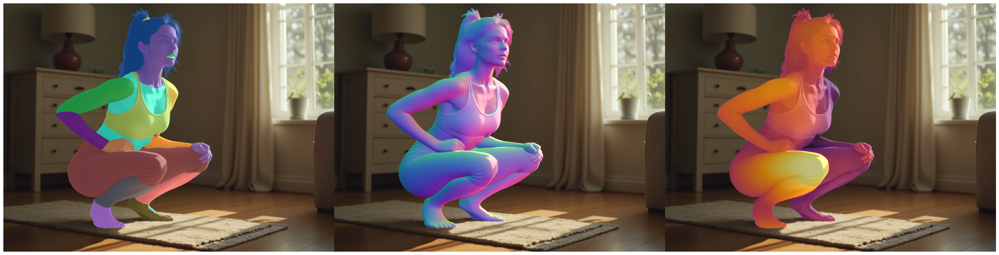

In [ ]:
from sapiens_inference import SapiensPredictor, SapiensConfig, SapiensDepthType, SapiensNormalType

config = SapiensConfig()
config.dtype = torch.float16
config.depth_type = SapiensDepthType.DEPTH_1B  # Disabled by default
config.normal_type = SapiensNormalType.NORMAL_1B  # Disabled by default
predictor = SapiensPredictor(config)

# Load the image
img = imread_from_url("https://github.com/ibaiGorordo/Sapiens-Pytorch-Inference/blob/assets/test2.png?raw=true")

# Estimate the maps
result = predictor(img)

result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

height, width, _ = result_rgb.shape

# Create a figure of the same size as the image
fig = plt.figure(figsize=(width / 100, height / 100), dpi=100)

# Display the image
plt.imshow(result_rgb)
plt.axis('off')  # Hide axis

# Save the figure in the original size
plt.savefig("yoga-predictor_output.png", bbox_inches='tight', pad_inches=0)
plt.show()

# Free the GPU memory
del predictor  # Delete the model
torch.cuda.empty_cache()  # Clear the GPU cache

### Multi Persons

Segmentation inference took: 2.6221 seconds
Normal inference took: 1.1421 seconds
Depth inference took: 1.1353 seconds


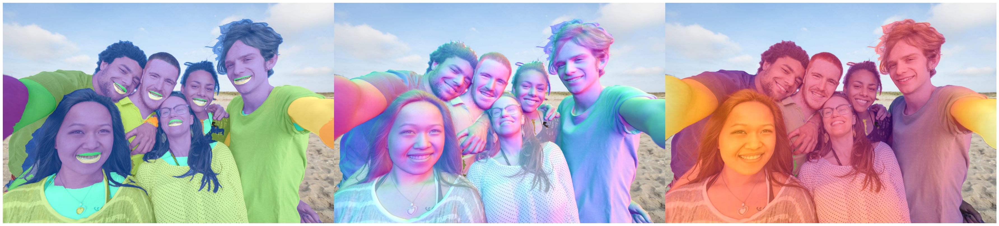

In [ ]:
from sapiens_inference import SapiensPredictor, SapiensConfig, SapiensDepthType, SapiensNormalType

config = SapiensConfig()
config.dtype = torch.float16
config.depth_type = SapiensDepthType.DEPTH_1B  # Disabled by default
config.normal_type = SapiensNormalType.NORMAL_1B  # Disabled by default
predictor = SapiensPredictor(config)

# Load the image
img = imread_from_url("https://learnopencv.com/wp-content/uploads/2024/09/multi-person-selfie-scaled.jpg")


# Estimate the maps
result = predictor(img)

result_rgb = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

height, width, _ = result_rgb.shape

# Create a figure of the same size as the image
fig = plt.figure(figsize=(width / 100, height / 100), dpi=100)

# Display the image
plt.imshow(result_rgb)
plt.axis('off')  # Hide axis

# Save the figure in the original size
plt.savefig("group_predictor_output.png", bbox_inches='tight', pad_inches=0)
plt.show()

# Free the GPU memory
del predictor  # Delete the model
torch.cuda.empty_cache()  # Clear the GPU cache

----

### Detector


0: 640x416 1 person, 1 sports ball, 27.7ms
Speed: 2.3ms preprocess, 27.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 416)
Detection inference took: 0.4950 seconds


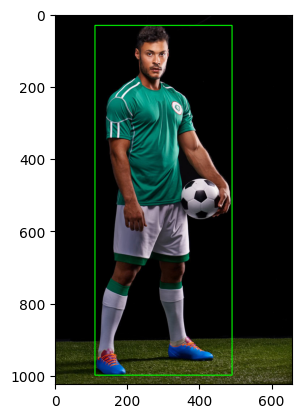

In [ ]:
from ultralytics import YOLO

@dataclass
class DetectorConfig:
    model_path: str = "models/yolov8m.pt"
    person_id: int = 0
    conf_thres: float = 0.25


def draw_boxes(img, boxes, color=(0, 255, 0), thickness=2):
    draw_img = img.copy()
    for box in boxes:
        x1, y1, x2, y2 = box
        draw_img = cv2.rectangle(draw_img, (x1, y1), (x2, y2), color, thickness)
    return draw_img


class Detector:
    def __init__(self, config: DetectorConfig = DetectorConfig()):
        model_path = config.model_path
        if not model_path.endswith(".pt"):
            model_path = model_path.split(".")[0] + ".pt"
        self.model = YOLO(model_path)
        self.person_id = config.person_id
        self.conf_thres = config.conf_thres

    def __call__(self, img: np.ndarray) -> np.ndarray:
        return self.detect(img)

    def detect(self, img: np.ndarray) -> np.ndarray:
        start = time.perf_counter()
        results = self.model(img, conf=self.conf_thres)
        detections = results[0].boxes.data.cpu().numpy()  # (x1, y1, x2, y2, conf, cls)

        # Filter out only person
        person_detections = detections[detections[:, -1] == self.person_id]
        boxes = person_detections[:, :-2].astype(int)

        print(f"Detection inference took: {time.perf_counter() - start:.4f} seconds")
        return boxes


if __name__ == "__main__":
    import cv2

    detector = Detector()
    img = cv2.imread("test_images/football.jpg")
    boxes = detector.detect(img)
    draw_img = draw_boxes(img, boxes)[:,:,::-1]
    plt.imshow(draw_img)
    plt.show()



### Surface Norm - Example 2

Normal inference took: 1.3819 seconds


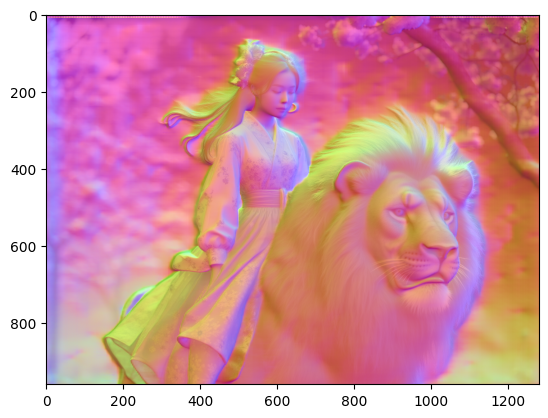

In [ ]:
from sapiens_inference.normal import SapiensNormal, SapiensNormalType, draw_normal_map

dtype = torch.float16
estimator = SapiensNormal(SapiensNormalType.NORMAL_1B, dtype=dtype)

img = imread_from_url("https://github.com/ibaiGorordo/Sapiens-Pytorch-Inference/blob/assets/test1.png?raw=true")

normal_map = estimator(img)

normal_map = draw_normal_map(normal_map)
combined = cv2.addWeighted(img, 0.3, normal_map, 0.8, 0)

plt.imshow(combined)

# Free the GPU memory
del estimator  # Delete the model
torch.cuda.empty_cache()  # Clear the GPU cache

### Body Part Segmentation - Example 2

Segmentation inference took: 1.7831 seconds


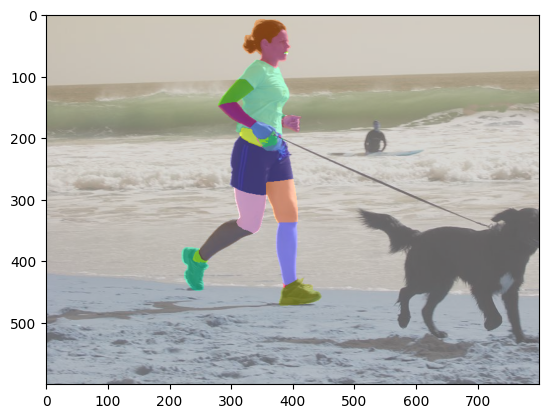

In [ ]:
import torch
import cv2
from imread_from_url import imread_from_url

from sapiens_inference.segmentation import SapiensSegmentation, SapiensSegmentationType, draw_segmentation_map

dtype = torch.float16
estimator = SapiensSegmentation(SapiensSegmentationType.SEGMENTATION_1B, dtype=dtype)

img = imread_from_url("https://upload.wikimedia.org/wikipedia/commons/5/5b/Jogging_with_dog_at_Carcavelos_Beach.jpg")

segmentation_map = estimator(img)

segmentation_image = draw_segmentation_map(segmentation_map)
combined = cv2.addWeighted(img, 0.5, segmentation_image, 0.7, 0)

plt.imshow(combined)


# Free the GPU memory
del estimator  # Delete the model
torch.cuda.empty_cache()  # Clear the GPU cache